In [1]:
# #pip install spotipy

In [2]:
import spotipy
import json
import pandas as pd
import pprint as pprint
import matplotlib.pyplot as plt
import statistics as stat
import numpy as np
from spotipy.oauth2 import SpotifyClientCredentials


client_credentials_manager = SpotifyClientCredentials(client_id='cb027b5487e347f9831660ff472bfffc',
                                                     client_secret='8fea847d34e2498d8b56f5f6564890f8')

sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

# playlists = sp.user_playlists('cole2571')
# while playlists:
#     for i, playlist in enumerate(playlists['items']):
#         print("%4d %s %s" % (i + 1 + playlists['offset'], playlist['uri'],  playlist['name']))
#     if playlists['next']:
#         playlists = sp.next(playlists)
#     else:
#         playlists = None

In [11]:
# top100tracks = sp.user_playlist("cole2571", playlist_id="7mmEld6NtxzgX6djzbhNKI", fields="tracks")

# print(json.dumps(top100tracks, indent=4, sort_keys=True))

In [12]:
# top100tracks["tracks"]["items"][0]["track"]["album"]["release_date"]

# top100tracks["tracks"]["items"][0]["track"]["popularity"]

In [13]:
# release_dates=[]
# uri=[]
# names=[]
# artists=[]
# isrc=[]
# popularity=[]

# for x in range (46):
    
#     print(x)
#     x=x*100
    
#     try:
#        top100tracks=sp.user_playlist_tracks('cole2571',playlist_id = '7mmEld6NtxzgX6djzbhNKI',fields="",offset=x)
#     except:
#         break
#     for i in range(len(top100tracks["items"])):
#         release_dates.append(top100tracks["items"][i]["track"]["album"]["release_date"])
#         uri.append(top100tracks["items"][i]["track"]["uri"])
#         names.append(top100tracks["items"][i]["track"]["name"])
#         artists.append(top100tracks["items"][i]["track"]["artists"][0]["name"])
#         isrc.append(top100tracks["items"][i]["track"]["external_ids"]["isrc"])
#         popularity.append(top100tracks["items"][i]["track"]["popularity"])
        
# popularity

In [14]:
# date_uri = list(zip(release_dates,uri,names,artists, isrc, popularity))
# date_uri_df = pd.DataFrame(date_uri)
# date_uri_df.columns=["release date", "uri", "song", "artist", "isrc", "popularity"]
# date_uri_df.head()

In [15]:
# top100tracks["tracks"]["items"][0]["track"]["uri"]

In [17]:
# loop through top100tracks and collect track URI, append to uris list

# analysis=[]

# for x in range (46):
    
#     print(x)
#     x=x*100
#     uri=[]
    
#     try:
#        top100tracks=sp.user_playlist_tracks('cole2571',playlist_id = '7mmEld6NtxzgX6djzbhNKI',fields="",offset=x)
#     except:
#         break
#     for i in range(len(top100tracks["items"])):
#         uri.append(top100tracks["items"][i]["track"]["uri"])
                
#         i+=1
   
#     analysis.append(sp.audio_features(uri))   

# analysis

In [18]:
# tracks_list =[]

# for tracks in analysis:
#     for track in tracks:
#         if track:
#             tracks_list.append(track)

# # for track in tracks_list:        
# #     if track is None:
#         print(track)

In [ ]:
# tracks_list_df = pd.DataFrame(tracks_list)


# # analysis = sp.audio_features(uri[0:100])

# # analysis

# # analysis[0].keys()

# # analysis[1]["danceability"]

# # features=[]

# # # for x in range(len(analysis["danceability"])):
    
# # #     features.append(analysis[x]["danceability"])
    
# # #     x+=1    


# # features

In [ ]:
# combined_df = pd.merge(date_uri_df, tracks_list_df, on='uri')
# combined_df["release date"].head()

In [19]:
# combined_df['year released'] = pd.DatetimeIndex(combined_df['release date']).year

# renamed_df = combined_df[["artist", "song", "uri", "year released","isrc", "acousticness", "danceability", "energy", "instrumentalness",
#                             "liveness", "loudness", "speechiness", "tempo", "duration_ms"]]

# renamed_df.sort_values(["year released"],ascending=[True])
# renamed_df.head()
# # year_counts=renamed_df["year released"].value_counts()
# # year_counts

# # plt.plot(renamed_df["loudness"])

# # renamed_df.to_csv(r'C:\users\brand\desktop\Homework\7-Project-1\export_df.csv',index=None, header=True)

In [4]:
billboard100_df = pd.read_csv('C:/Users/brand/Desktop/Homework/7-Project-1/billboard_top_10_annual.csv', encoding="windows-1252")
billboard100_df

# len(billboard100_df)["Songs"]

# billboard_sort = billboard100_df.sort_values(["Rank"], ascending=[True])
# billboard_sort = billboard_sort.groupby(["Rank"])

,Rank,Artist,Song,Year,ArtistSong
0,1,Gordon Jenkins and The Weavers,Goodnight Irene,1950,Gordon Jenkins and The WeaversGoodnight Irene
1,2,Nat King Cole,Mona Lisa,1950,Nat King ColeMona Lisa
2,3,Anton Karas,Third Man Theme,1950,Anton KarasThird Man Theme
3,4,Gary and Bing Crosby,Sam’s Song,1950,Gary and Bing CrosbySam’s Song
4,5,Gary and Bing Crosby,Simple Melody,1950,Gary and Bing CrosbySimple Melody
5,6,Teresa Brewer,"Music, Music, Music",1950,"Teresa BrewerMusic, Music, Music"
6,7,Guy Lombardo,Third Man Theme,1950,Guy LombardoThird Man Theme
7,8,Red Foley,Chattanoogie Shoe Shine Boy,1950,Red FoleyChattanoogie Shoe Shine Boy
8,9,Sammy Kaye,Harbor Lights,1950,Sammy KayeHarbor Lights
9,10,Sammy Kaye and Don Cornell,It Isn’t Fair,1950,Sammy Kaye and Don CornellIt Isn’t Fair


In [6]:
new_uri=[]

for i in range(len(billboard100_df["Song"])):
    try:
        new_uri.append(sp.search(q='artist:' + billboard100_df["Artist"][i] +
                             ' track:' + billboard100_df["Song"][i], type='track'))
    except: 
        continue
    i+=1
                 
new_uri

retrying ...1secs
retrying ...1secs
retrying ...1secs


[{'tracks': {'href': 'https://api.spotify.com/v1/search?query=artist%3AGordon+Jenkins+and+The+Weavers+track%3AGoodnight+Irene&type=track&offset=0&limit=10',
   'items': [{'album': {'album_type': 'album',
      'artists': [{'external_urls': {'spotify': 'https://open.spotify.com/artist/4E5eAkpbJLO40r8fWNWm6X'},
        'href': 'https://api.spotify.com/v1/artists/4E5eAkpbJLO40r8fWNWm6X',
        'id': '4E5eAkpbJLO40r8fWNWm6X',
        'name': 'The Weavers',
        'type': 'artist',
        'uri': 'spotify:artist:4E5eAkpbJLO40r8fWNWm6X'}],
      'available_markets': ['CA', 'MX', 'US'],
      'external_urls': {'spotify': 'https://open.spotify.com/album/2toLqFxW0d6AqFdadPOei1'},
      'href': 'https://api.spotify.com/v1/albums/2toLqFxW0d6AqFdadPOei1',
      'id': '2toLqFxW0d6AqFdadPOei1',
      'images': [{'height': 640,
        'url': 'https://i.scdn.co/image/f0408756c5dd6619339e58fea272d01398b1eed5',
        'width': 640},
       {'height': 300,
        'url': 'https://i.scdn.co/image/12f

In [7]:
len(new_uri)

670

In [8]:
analysis=[]

uri=[]
empties=[]   

for i in range(len(new_uri)):
    try:
        uri.append(new_uri[i]['tracks']["items"][0]["uri"])     
    except Exception as e:
        print(e)
        print(new_uri[i]['tracks']["items"])
        empties.append(new_uri[i]['tracks']["items"])

    try:
        analysis.append(sp.audio_features(new_uri[i]['tracks']["items"][0]["uri"]))
    except Exception as e:
        print(e)
        
analysis

list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list index out of range
list index out of range
[]
list

[[{'danceability': 0.367,
   'energy': 0.261,
   'key': 5,
   'loudness': -10.404,
   'mode': 1,
   'speechiness': 0.0289,
   'acousticness': 0.832,
   'instrumentalness': 0,
   'liveness': 0.172,
   'valence': 0.576,
   'tempo': 140.82,
   'type': 'audio_features',
   'id': '1fhLgOJgIIZEsWWffk8ljs',
   'uri': 'spotify:track:1fhLgOJgIIZEsWWffk8ljs',
   'track_href': 'https://api.spotify.com/v1/tracks/1fhLgOJgIIZEsWWffk8ljs',
   'analysis_url': 'https://api.spotify.com/v1/audio-analysis/1fhLgOJgIIZEsWWffk8ljs',
   'duration_ms': 202240,
   'time_signature': 3}],
 [{'danceability': 0.251,
   'energy': 0.225,
   'key': 1,
   'loudness': -12.125,
   'mode': 1,
   'speechiness': 0.0347,
   'acousticness': 0.948,
   'instrumentalness': 0,
   'liveness': 0.114,
   'valence': 0.324,
   'tempo': 166.32,
   'type': 'audio_features',
   'id': '5dae01pKNjRQtgOeAkFzPY',
   'uri': 'spotify:track:5dae01pKNjRQtgOeAkFzPY',
   'track_href': 'https://api.spotify.com/v1/tracks/5dae01pKNjRQtgOeAkFzPY',
   

In [9]:
len(analysis)

549

In [10]:
tracks_list =[]

for tracks in analysis:
    for track in tracks:
        if track:
            tracks_list.append(track)

In [11]:
tracks_list_df = pd.DataFrame(tracks_list)
tracks_list_df

,acousticness,analysis_url,danceability,duration_ms,energy,id,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,track_href,type,uri,valence
0,0.83200,https://api.spotify.com/v1/audio-analysis/1fhL...,0.367,202240,0.2610,1fhLgOJgIIZEsWWffk8ljs,0.000000,5,0.1720,-10.404,1,0.0289,140.820,3,https://api.spotify.com/v1/tracks/1fhLgOJgIIZE...,audio_features,spotify:track:1fhLgOJgIIZEsWWffk8ljs,0.5760
1,0.94800,https://api.spotify.com/v1/audio-analysis/5dae...,0.251,194987,0.2250,5dae01pKNjRQtgOeAkFzPY,0.000000,1,0.1140,-12.125,1,0.0347,166.320,5,https://api.spotify.com/v1/tracks/5dae01pKNjRQ...,audio_features,spotify:track:5dae01pKNjRQtgOeAkFzPY,0.3240
2,0.91100,https://api.spotify.com/v1/audio-analysis/68GJ...,0.473,149964,0.1610,68GJRIs9vkHFy9l0Sbdsix,0.909000,0,0.0977,-17.505,1,0.0328,131.775,4,https://api.spotify.com/v1/tracks/68GJRIs9vkHF...,audio_features,spotify:track:68GJRIs9vkHFy9l0Sbdsix,0.3640
3,0.77100,https://api.spotify.com/v1/audio-analysis/33Fd...,0.630,175693,0.2220,33FdwvfiSBRbE2AQ4UehaR,0.000002,10,0.1840,-13.740,1,0.0522,138.497,3,https://api.spotify.com/v1/tracks/33FdwvfiSBRb...,audio_features,spotify:track:33FdwvfiSBRbE2AQ4UehaR,0.7780
4,0.68800,https://api.spotify.com/v1/audio-analysis/68ZO...,0.761,162400,0.4480,68ZOKozM9xmlp1iwaQSwY7,0.000019,7,0.1130,-14.350,1,0.0402,99.078,4,https://api.spotify.com/v1/tracks/68ZOKozM9xml...,audio_features,spotify:track:68ZOKozM9xmlp1iwaQSwY7,0.9280
5,0.88500,https://api.spotify.com/v1/audio-analysis/5uEw...,0.788,179040,0.1580,5uEwpyOYHFGqme4WnVQhfs,0.627000,0,0.1010,-12.071,1,0.0365,115.551,4,https://api.spotify.com/v1/tracks/5uEwpyOYHFGq...,audio_features,spotify:track:5uEwpyOYHFGqme4WnVQhfs,0.5690
6,0.61700,https://api.spotify.com/v1/audio-analysis/7Jf3...,0.740,169000,0.3820,7Jf323ttHKUnPylFWiaGl3,0.005490,10,0.1160,-15.948,1,0.0563,148.269,4,https://api.spotify.com/v1/tracks/7Jf323ttHKUn...,audio_features,spotify:track:7Jf323ttHKUnPylFWiaGl3,0.8360
7,0.98500,https://api.spotify.com/v1/audio-analysis/00vJ...,0.323,198733,0.0872,00vJeips2Rwr2qN1qODvyf,0.009920,2,0.1130,-18.891,1,0.0325,85.325,4,https://api.spotify.com/v1/tracks/00vJeips2Rwr...,audio_features,spotify:track:00vJeips2Rwr2qN1qODvyf,0.1550
8,0.91200,https://api.spotify.com/v1/audio-analysis/3RxI...,0.411,200787,0.2060,3RxI4EHxmNqd7nHJPqbxUm,0.002900,0,0.3640,-12.480,1,0.0353,69.193,4,https://api.spotify.com/v1/tracks/3RxI4EHxmNqd...,audio_features,spotify:track:3RxI4EHxmNqd7nHJPqbxUm,0.3000
9,0.80500,https://api.spotify.com/v1/audio-analysis/0zII...,0.201,204627,0.2130,0zII0Soax7wbm3Avw7iVAd,0.000082,8,0.1260,-14.531,1,0.0298,96.324,4,https://api.spotify.com/v1/tracks/0zII0Soax7wb...,audio_features,spotify:track:0zII0Soax7wbm3Avw7iVAd,0.2030


In [12]:
artists=[]
songs=[]
popularity=[]

for i in tracks_list_df["uri"]:
    artists.append(sp.track(i)["album"]["artists"][0]["name"])
    songs.append(sp.track(i)["name"])
    popularity.append(sp.track(i)["popularity"])

In [15]:
tracks_list_df["Artist"]=artists
tracks_list_df["Songs"]=songs
tracks_list_df["Popularity"]=popularity

tracks_list_df.columns

final_df = tracks_list_df.rename(columns={'acousticness':"Acousticness", 'danceability':"Danceability", 
                                          'duration_ms':"Duration (ms)", 'energy':"Energy",'instrumentalness':"Instrumentalness",
                                          'key':"Key", 'liveness':"Liveness", 'loudness':"Loudness", 'mode':"Mode",
                                          'speechiness':"Speechiness",'tempo':"Tempo", 'time_signature':"Time-Sig",
                                          'uri':"URI", 'valence':"Valence", 'Artist':"Artist",'Songs':"Song",
                                          'Popularity':"Popularity"})

final_df = final_df.drop(["Key", "Mode","Time-Sig"], axis=1)

final_df = final_df[["Artist" , "Song", "Popularity", "Acousticness", "Danceability", 
             "Energy", "Instrumentalness", "Loudness", "Speechiness","Tempo", "Valence", "Duration (ms)", "URI"]]

final_df = final_df.set_index("URI")

final_df

,Artist,Song,Popularity,Acousticness,Danceability,Energy,Instrumentalness,Loudness,Speechiness,Tempo,Valence,Duration (ms)
URI,,,,,,,,,,,,
spotify:track:1fhLgOJgIIZEsWWffk8ljs,The Weavers,Goodnight Irene,13,0.83200,0.367,0.2610,0.000000,-10.404,0.0289,140.820,0.5760,202240
spotify:track:5dae01pKNjRQtgOeAkFzPY,Nat King Cole,Mona Lisa,51,0.94800,0.251,0.2250,0.000000,-12.125,0.0347,166.320,0.3240,194987
spotify:track:68GJRIs9vkHFy9l0Sbdsix,Various Artists,The Third Man (The Harry Lime Theme),12,0.91100,0.473,0.1610,0.909000,-17.505,0.0328,131.775,0.3640,149964
spotify:track:33FdwvfiSBRbE2AQ4UehaR,Bing Crosby,Play A Simple Melody - Single Version,10,0.77100,0.630,0.2220,0.000002,-13.740,0.0522,138.497,0.7780,175693
spotify:track:68ZOKozM9xmlp1iwaQSwY7,Teresa Brewer,Music! Music! Music!,26,0.68800,0.761,0.4480,0.000019,-14.350,0.0402,99.078,0.9280,162400
spotify:track:5uEwpyOYHFGqme4WnVQhfs,Guy Lombardo,The Third Man Theme,9,0.88500,0.788,0.1580,0.627000,-12.071,0.0365,115.551,0.5690,179040
spotify:track:7Jf323ttHKUnPylFWiaGl3,Red Foley,Chattanoogie Shoe Shine Boy - 1949 Single Version,32,0.61700,0.740,0.3820,0.005490,-15.948,0.0563,148.269,0.8360,169000
spotify:track:00vJeips2Rwr2qN1qODvyf,Various Artists,Harbor Lights,12,0.98500,0.323,0.0872,0.009920,-18.891,0.0325,85.325,0.1550,198733
spotify:track:3RxI4EHxmNqd7nHJPqbxUm,Sammy Kaye,It Isn't Fair,3,0.91200,0.411,0.2060,0.002900,-12.480,0.0353,69.193,0.3000,200787


In [19]:
final_df.to_csv("final.csv", index=True, header=True)

In [116]:
merged_df = pd.read_csv('C:/Users/brand/Desktop/Homework/7-Project-1/final.csv', encoding="windows-1252")

love = merged_df['Song'].str.lower().str.contains('love', na=False)

merged_df["Love"]=love

merged_df 

,URI,Artist,Song,Release Date,Popularity,Acousticness,Danceability,Energy,Instrumentalness,Loudness,Speechiness,Tempo,Valence,Duration (ms),Unnamed: 14,WH,War?,Love
0,spotify:track:1fhLgOJgIIZEsWWffk8ljs,The Weavers,Goodnight Irene,1950,13,0.83200,0.367,0.2610,0.000000,-10.404,0.0289,140.820,0.5760,202240,Goodnight Irene,D,War,False
1,spotify:track:5dae01pKNjRQtgOeAkFzPY,Nat King Cole,Mona Lisa,1950,51,0.94800,0.251,0.2250,0.000000,-12.125,0.0347,166.320,0.3240,194987,Mona Lisa,D,War,False
2,spotify:track:68GJRIs9vkHFy9l0Sbdsix,Various Artists,The Third Man (The Harry Lime Theme),1950,12,0.91100,0.473,0.1610,0.909000,-17.505,0.0328,131.775,0.3640,149964,The Third Man (The Harry Lime Theme),D,War,False
3,spotify:track:33FdwvfiSBRbE2AQ4UehaR,Bing Crosby,Play A Simple Melody - Single Version,1950,10,0.77100,0.630,0.2220,0.000002,-13.740,0.0522,138.497,0.7780,175693,Play A Simple Melody - Single Version,D,War,False
4,spotify:track:68ZOKozM9xmlp1iwaQSwY7,Teresa Brewer,Music! Music! Music!,1950,26,0.68800,0.761,0.4480,0.000019,-14.350,0.0402,99.078,0.9280,162400,Music! Music! Music!,D,War,False
5,spotify:track:5uEwpyOYHFGqme4WnVQhfs,Guy Lombardo,The Third Man Theme,1950,9,0.88500,0.788,0.1580,0.627000,-12.071,0.0365,115.551,0.5690,179040,The Third Man Theme,D,War,False
6,spotify:track:7Jf323ttHKUnPylFWiaGl3,Red Foley,Chattanoogie Shoe Shine Boy - 1949 Single Version,1950,32,0.61700,0.740,0.3820,0.005490,-15.948,0.0563,148.269,0.8360,169000,Chattanoogie Shoe Shine Boy - 1949 Single Version,D,War,False
7,spotify:track:00vJeips2Rwr2qN1qODvyf,Various Artists,Harbor Lights,1950,12,0.98500,0.323,0.0872,0.009920,-18.891,0.0325,85.325,0.1550,198733,Harbor Lights,D,War,False
8,spotify:track:3RxI4EHxmNqd7nHJPqbxUm,Sammy Kaye,It Isn't Fair,1950,3,0.91200,0.411,0.2060,0.002900,-12.480,0.0353,69.193,0.3000,200787,It Isn't Fair,D,War,False
9,spotify:track:0zII0Soax7wbm3Avw7iVAd,Nat King Cole,Too Young,1951,41,0.80500,0.201,0.2130,0.000082,-14.531,0.0298,96.324,0.2030,204627,Too Young,D,War,False


In [150]:
bins = [1949,1959,1969,1979,1989,1999,2009,2019]
group_names=["1950s","1960s","1970s","1980s","1990s","2000s","2010s"]

merged_df["Decade"] = pd.cut(merged_df["Release Date"], bins, labels=group_names)
merged_df

,URI,Artist,Song,Release Date,Popularity,Acousticness,Danceability,Energy,Instrumentalness,Loudness,Speechiness,Tempo,Valence,Duration (ms),Unnamed: 14,WH,War?,Love,Decade
0,spotify:track:1fhLgOJgIIZEsWWffk8ljs,The Weavers,Goodnight Irene,1950,13,0.83200,0.367,0.2610,0.000000,-10.404,0.0289,140.820,0.5760,202240,Goodnight Irene,D,War,False,1950s
1,spotify:track:5dae01pKNjRQtgOeAkFzPY,Nat King Cole,Mona Lisa,1950,51,0.94800,0.251,0.2250,0.000000,-12.125,0.0347,166.320,0.3240,194987,Mona Lisa,D,War,False,1950s
2,spotify:track:68GJRIs9vkHFy9l0Sbdsix,Various Artists,The Third Man (The Harry Lime Theme),1950,12,0.91100,0.473,0.1610,0.909000,-17.505,0.0328,131.775,0.3640,149964,The Third Man (The Harry Lime Theme),D,War,False,1950s
3,spotify:track:33FdwvfiSBRbE2AQ4UehaR,Bing Crosby,Play A Simple Melody - Single Version,1950,10,0.77100,0.630,0.2220,0.000002,-13.740,0.0522,138.497,0.7780,175693,Play A Simple Melody - Single Version,D,War,False,1950s
4,spotify:track:68ZOKozM9xmlp1iwaQSwY7,Teresa Brewer,Music! Music! Music!,1950,26,0.68800,0.761,0.4480,0.000019,-14.350,0.0402,99.078,0.9280,162400,Music! Music! Music!,D,War,False,1950s
5,spotify:track:5uEwpyOYHFGqme4WnVQhfs,Guy Lombardo,The Third Man Theme,1950,9,0.88500,0.788,0.1580,0.627000,-12.071,0.0365,115.551,0.5690,179040,The Third Man Theme,D,War,False,1950s
6,spotify:track:7Jf323ttHKUnPylFWiaGl3,Red Foley,Chattanoogie Shoe Shine Boy - 1949 Single Version,1950,32,0.61700,0.740,0.3820,0.005490,-15.948,0.0563,148.269,0.8360,169000,Chattanoogie Shoe Shine Boy - 1949 Single Version,D,War,False,1950s
7,spotify:track:00vJeips2Rwr2qN1qODvyf,Various Artists,Harbor Lights,1950,12,0.98500,0.323,0.0872,0.009920,-18.891,0.0325,85.325,0.1550,198733,Harbor Lights,D,War,False,1950s
8,spotify:track:3RxI4EHxmNqd7nHJPqbxUm,Sammy Kaye,It Isn't Fair,1950,3,0.91200,0.411,0.2060,0.002900,-12.480,0.0353,69.193,0.3000,200787,It Isn't Fair,D,War,False,1950s
9,spotify:track:0zII0Soax7wbm3Avw7iVAd,Nat King Cole,Too Young,1951,41,0.80500,0.201,0.2130,0.000082,-14.531,0.0298,96.324,0.2030,204627,Too Young,D,War,False,1950s


In [142]:
group_by_decade_df = merged_df.groupby("Decade")

group_by_decade_df["Popularity","Acousticness","Danceability","Energy","Instrumentalness",
                   "Loudness","Speechiness","Duration (ms)","Love"].mean()


group_by_decade_df = group_by_decade_df.agg({"Popularity":"mean","Acousticness":"mean",
                                          "Danceability":"mean","Energy":"mean","Instrumentalness":"mean",
                   "Loudness":"mean","Speechiness":"mean","Duration (ms)":"mean","Love":"sum"})

group_by_decade_df

,Popularity,Acousticness,Danceability,Energy,Instrumentalness,Loudness,Speechiness,Duration (ms),Love
Decade,,,,,,,,,
1950s,34.312500,0.775090,0.480525,0.341433,0.100617,-12.108950,0.046331,168631.575000,8.0
1960s,51.325000,0.525127,0.548412,0.510381,0.069575,-10.085350,0.043100,176392.312500,10.0
1970s,54.302326,0.393561,0.613953,0.543233,0.011384,-10.723128,0.051335,237202.430233,11.0
1980s,62.908046,0.211094,0.651379,0.651724,0.025305,-9.050460,0.043109,251194.735632,7.0
1990s,60.095238,0.238472,0.655452,0.577095,0.015846,-8.642869,0.054877,265042.714286,10.0
2000s,63.341772,0.170444,0.679367,0.684633,0.013573,-5.907532,0.084182,236843.683544,7.0
2010s,69.705882,0.181588,0.666686,0.680961,0.015200,-5.613412,0.095973,231982.294118,1.0


In [49]:
group_by_wh_df = merged_df.groupby("WH")

group_by_wh_df.agg({"Popularity":"mean","Acousticness":"mean",
                                          "Danceability":"mean","Energy":"mean","Instrumentalness":"mean",
                   "Loudness":"mean","Speechiness":"mean","Duration (ms)":"mean","Love":"sum"})

,Popularity,Acousticness,Danceability,Energy,Instrumentalness,Loudness,Speechiness,Duration (ms),Love
WH,,,,,,,,,
D,55.750988,0.378163,0.601775,0.548234,0.043373,-8.845925,0.056373,223482.948617,27.0
R,56.108844,0.351399,0.619949,0.578745,0.030617,-9.272395,0.058545,224895.959184,27.0


In [50]:
group_by_war_df = merged_df.groupby("War?")

group_by_war_df.agg({"Popularity":"mean","Acousticness":"mean",
                                          "Danceability":"mean","Energy":"mean","Instrumentalness":"mean",
                   "Loudness":"mean","Speechiness":"mean","Duration (ms)":"mean","Love":"sum"})

,Popularity,Acousticness,Danceability,Energy,Instrumentalness,Loudness,Speechiness,Duration (ms),Love
War?,,,,,,,,,
Peace,57.335227,0.340059,0.624293,0.576332,0.032208,-9.102494,0.054343,226398.775568,36.0
War,53.430769,0.406593,0.588528,0.543513,0.044294,-9.025769,0.063311,220349.892308,18.0


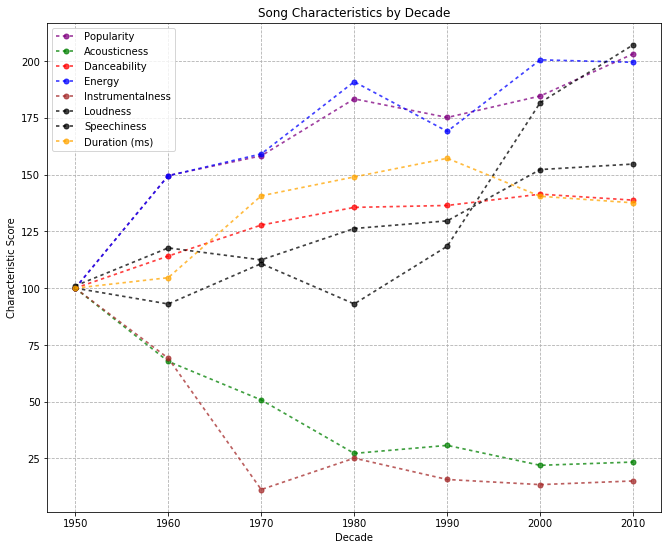

In [189]:
x_axis = np.arange(1950,2020,10)

# AcousticnessSem=group_by_decade_df.sem()["Acousticness"]
# DanceSem=group_by_decade_df.sem()["Danceability"]
# EnergySem=group_by_decade_df.sem()["Energy"]
# InstrumentalnessSem=group_by_decade_df.sem()["Instrumentalness"]
# AcousticnessSem=group_by_decade_df.sem()["Acousticness"]
# SpeechinessSem=group_by_decade_df.sem()["Speechiness"]
# DanceSem=group_by_decade_df.sem()["Danceability"]

fig, ax = plt.subplots(figsize=(11,9))

ax.errorbar(x_axis, group_by_decade_df["Popularity"]/34.312500*100, color="purple", marker="o", markersize=5, label="Popularity", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, group_by_decade_df["Acousticness"]/.775090*100, color="green", marker="o", markersize=5, label="Acousticness", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, group_by_decade_df["Danceability"]/.480525*100, color="red", marker="o", markersize=5, label="Danceability", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, group_by_decade_df["Energy"]/.341433*100, color="blue", marker="o", markersize=5, label="Energy", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, group_by_decade_df["Instrumentalness"]/.100617*100, color="brown", marker="o", markersize=5, label="Instrumentalness", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, (1+(1-(group_by_decade_df["Loudness"]/(-12.108950)))*100)+100, color="black", marker="o", markersize=5, label="Loudness", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, group_by_decade_df["Speechiness"]/.046331*100, color="black", marker="o", markersize=5, label="Speechiness", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)
ax.errorbar(x_axis, group_by_decade_df["Duration (ms)"]/168631.575000*100, color="orange", marker="o", markersize=5, label="Duration (ms)", dashes=[2, 2, 2, 2], alpha =.75, linewidth=1.7)


plt.title("Song Characteristics by Decade")
plt.xlabel("Decade")
plt.ylabel("Characteristic Score")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

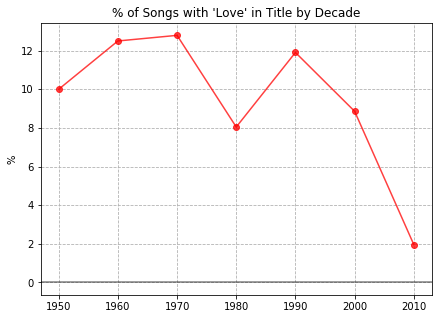

In [157]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

        
ax.errorbar(x_axis, group_by_decade_df["Love"]/pd.value_counts(merged_df['Decade'].values, sort=False)*100,
        fmt="-o", color="r",alpha=0.75, label="Love")

plt.title("% of Songs with 'Love' in Title by Decade")
plt.ylabel("%")
plt.grid(linestyle="dashed")
plt.axhline(y=0,color="black", alpha=0.5)

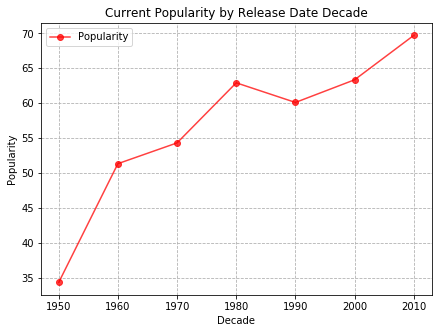

In [51]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Popularity"], fmt="-o", color="r",alpha=0.75, label="Popularity")

plt.title("Current Popularity by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Popularity")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

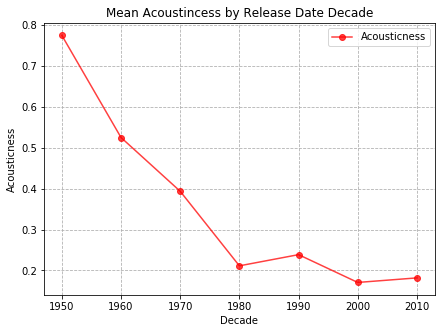

In [52]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Acousticness"], fmt="-o", color="r",alpha=0.75, label="Acousticness")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Acoustincess by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Acousticness")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

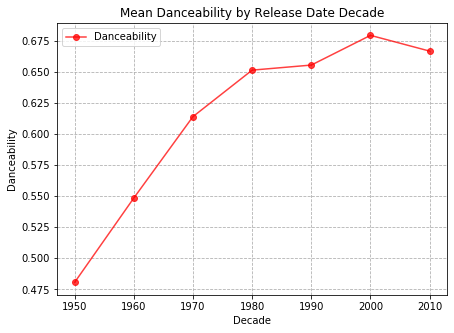

In [53]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Danceability"], fmt="-o", color="r",alpha=0.75, label="Danceability")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Danceability by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Danceability")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

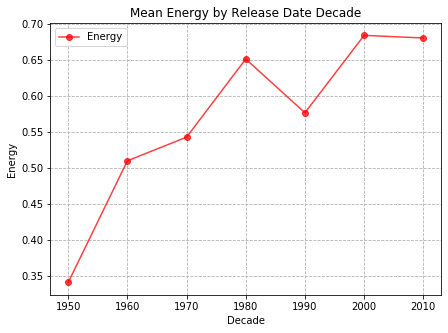

In [54]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Energy"], fmt="-o", color="r",alpha=0.75, label="Energy")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Energy by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Energy")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

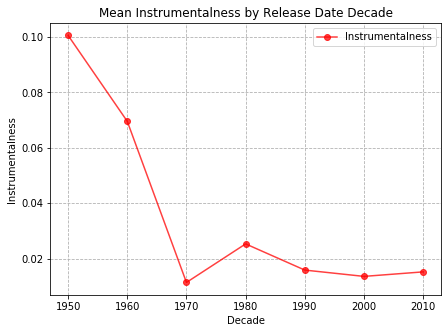

In [55]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Instrumentalness"], fmt="-o", color="r",alpha=0.75, label="Instrumentalness")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Instrumentalness by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Instrumentalness")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

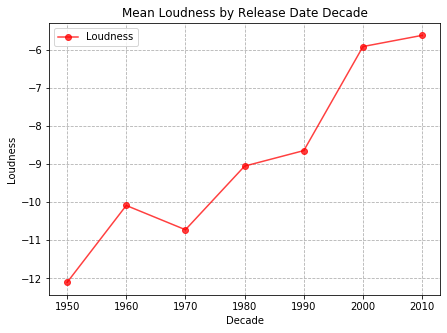

In [56]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Loudness"], fmt="-o", color="r",alpha=0.75, label="Loudness")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Loudness by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Loudness")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

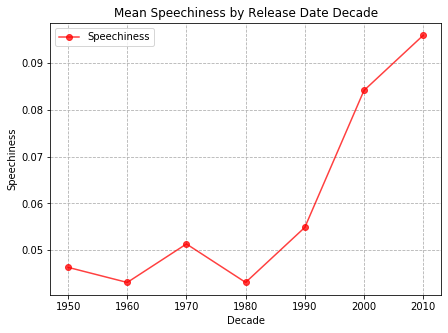

In [57]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Speechiness"], fmt="-o", color="r",alpha=0.75, label="Speechiness")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Speechiness by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Speechiness")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

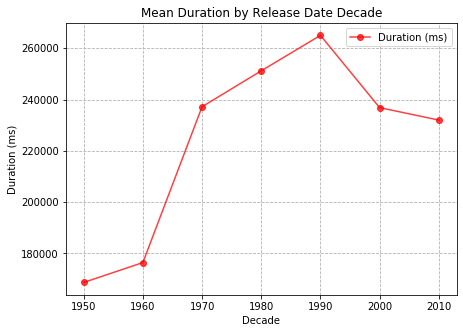

In [60]:
x_axis = np.arange(1950,2020, 10)

fig, ax = plt.subplots(figsize=(7,5))

ax.errorbar(x_axis, group_by_decade_df["Duration (ms)"], fmt="-o", color="r",alpha=0.75, label="Duration (ms)")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Ketapril"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Ketapril"], fmt="--s", color="g",
#             alpha=0.75, label="Ketapril")

# ax.errorbar(x_axis, tumor_vol_mean["Tumor Volume (mm3)"]["Placebo"], 
#                                    yerr=tumor_vol_sem["Standard Error"]["Placebo"], fmt="--d", color="0",
#             alpha=0.75, label="Placebo")

plt.title("Mean Duration by Release Date Decade")
plt.xlabel("Decade")
plt.ylabel("Duration (ms)")
plt.grid(linestyle="dashed")
plt.legend()
plt.show()

TypeError: unhashable type: 'numpy.ndarray'

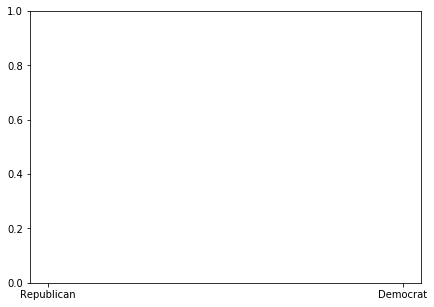

In [190]:
x_axis = ["Republican","Democrat"]

fig, ax = plt.subplots(figsize=(7,5))

        
plt.bar(x_axis, group_by_wh_df["Duration (ms)"],width=1, color="r", alpha=0.6,edgecolor="black", linewidth=2)

plt.title("Tumor Change Over 45 Day Treatment")
plt.ylabel("Tumor Volume Change (%)")
plt.grid(linestyle="dashed")
plt.axhline(y=0,color="black", alpha=0.5)